# Домашнее задание 3
## Сравнение интересов аудитории телеканалов НТВ и Дождь с помощью тематического моделирования LDA

Задача:
Сравнить интересы аудитории телеканолов НТВ и Дождь с помощью методов тематического моделирования
1. Получить данные по аудитории из социальной сети ВК
2. Зарегистрировать приложение, получить app_id, access_token
3. Скачать данные по пользователям в каждой из групп (id групп ВК даны ниже, tvrain_id, ntv_id)
4. Взять небольшую выборку из каждой совокупности телезрителей(около 1000-2000 человек, т.к. 300k-400k слишком много), с которыми работать дальше
5. Обучить LDA модель на их подписках
6. По группам, на которые подписаны эти люди, полуичть ключевые слова групп, на которые они подписаны
7. Получить распределение интересов людей для каждой совокупности, сравнить на графике

In [1]:
import seaborn as sb
import sys  
import pandas as pd
import requests
import numpy as np
import datetime
import time
import pickle
import matplotlib.pyplot as plt
import time
%matplotlib inline

from bs4 import BeautifulSoup as bs
import urllib

In [2]:
def load_obj(name):
    with open(name + '.pkl', 'rb') as f:
        return pickle.load(f)

def save_obj(obj, name):
    with open(name + '.pkl', 'wb') as f:
        pickle.dump(obj, f, pickle.HIGHEST_PROTOCOL)

#### Для использования VK API необходимо создать приложение в VK

1. Создать приложение по адресу https://vk.com/apps?act=manage (кнопка "создать приложение")
2. При создании указать название, описание (можно любые), категория  - прочее. Тип - standalone приложение
3. В настройках получить **app_id**. App_id потребуется для получения access token
4. Авторизовать пользователя (получить access token) можно по адресу: https://vk.com/dev/first_guide, в правилах нас интересует пункт 3 **Авторизация пользователя**
5. После того, как ознакомитесь с авторизацией пользователя, скопируйте в адресную строку такой запрос https://oauth.vk.com/authorize?client_id=5490057&display=page&redirect_uri=https://oauth.vk.com/blank.html&scope=friends&response_type=token&v=5.52, где число **5490057** замените на число, которое получите для вашего **app_id**
6. Нажмите Enter. Откроется окно с запросом прав. В нем отображаются название приложения, иконки прав доступа, и Ваши имя с фамилией. Нажмите «Разрешить». Вы попадете на новую страницу с предупреждением о том, что токен нельзя копировать и передавать третьим лицам. В адресной строке будет URL https://oauth.vk.com/blank.html, а после # Вы увидите дополнительные параметры — access_token, expires_in и user_id. Токен может выглядеть, например, так: 51eff86578a3bbbcb5c7043a122a69fd04dca057ac821dd7afd7c2d8e35b60172d45a26599c08034cc40a
7. Токен — это Ваш ключ доступа. При выполнении определенных условий человек, получивший Ваш токен, может нанести существенный ущерб Вашим данным и данным других людей. Поэтому очень важно не передавать свой токен третьим лицам
8. Поле expires_in содержит время жизни токена в секундах. 86400 секунд — это ровно сутки. Через сутки полученный токен перестанет действовать, для продолжения работы нужно будет получить новый по такому же алгоритму

In [128]:
# use your own app id and respective tokens

# скопируйте сюда ваши app_id и access_token, полученные по методу, описанному выше
app_id = 6894360
access_token = 'b94f7031dbc88394d9843e0c609733919d230788192647e713295bb228a3a7fec41db76d9a19cca67579b'

# id групп ВК Дождя и НТВ
tvrain_id = 17568841
ntv_id = 28658784

In [129]:
# проверка работы API и авторизации пользователя. Если возникает ошибка, то, возможно, access token необходимо обновить
check_id = 1

# api call and test
def vk_get_response(method, parameters, token):
    url = 'https://api.vk.com/method/' + method + '?' + parameters + '&access_token=' + token
#     print url
    return(requests.get(url).json())

answer = vk_get_response(
    'users.get', 'user_ids={0}&v=4.9&lang=ru'.format(check_id), access_token
)['response']
print(answer[0]['first_name'], answer[0]['last_name'])

Павел Дуров


In [130]:
 vk_get_response(
    'users.get', 'user_ids={0}&v=4.9&lang=ru'.format(check_id), access_token
)

{'response': [{'uid': 1, 'first_name': 'Павел', 'last_name': 'Дуров'}]}

### Получение подписчиков телеканалов НТВ и Дождь в VK

Получим объекты, которые содержат всю информацию о подпиичиках соответствующих групп (указанных в domains) и сохраним их на диск. Получим в итоге два файла - **ntv_subs** и **tvrain_subs** в формате **.pkl** - питоновский формат хранения данных

In [7]:
domains = ['ntv', 'tvrain']


for group_domain in domains:
    offset = 0
    group_id = group_domain
    fields = """sex,bdate,city,country,home_town,lists,domain,has_mobile,
    contacts,connections,education,universities,followers_count,occupation,last_seen,relation"""
    first_sample = vk_get_response(
        'groups.getMembers', 'group_id={0}&offset={1}&fields={2}&v=4.9&lang=ru'.format(
            group_id, offset, fields
        ), token=access_token
    )
    community_count = first_sample['response']['count']
    community_members = []
    for i in range(community_count // 1000 + 1):
        offset = i * 1000
        try:
            answer = vk_get_response(
                'groups.getMembers', 'group_id={0}&offset={1}&fields={2}&v=4.9&lang=ru'.format(
                    group_id, offset, fields), token=access_token
            )
            print("Offset: ", offset)
        except:
            print("Offset: ", offset, " Error")
        community_members += answer['response']['users']
    save_obj(community_members, '{}_subs'.format(group_domain))

Offset:  0
Offset:  1000
Offset:  2000
Offset:  3000
Offset:  4000
Offset:  5000
Offset:  6000
Offset:  7000
Offset:  8000
Offset:  9000
Offset:  10000
Offset:  11000
Offset:  12000
Offset:  13000
Offset:  14000
Offset:  15000
Offset:  16000
Offset:  17000
Offset:  18000
Offset:  19000
Offset:  20000
Offset:  21000
Offset:  22000
Offset:  23000
Offset:  24000
Offset:  25000
Offset:  26000
Offset:  27000
Offset:  28000
Offset:  29000
Offset:  30000
Offset:  31000
Offset:  32000
Offset:  33000
Offset:  34000
Offset:  35000
Offset:  36000
Offset:  37000
Offset:  38000
Offset:  39000
Offset:  40000
Offset:  41000
Offset:  42000
Offset:  43000
Offset:  44000
Offset:  45000
Offset:  46000
Offset:  47000
Offset:  48000
Offset:  49000
Offset:  50000
Offset:  51000
Offset:  52000
Offset:  53000
Offset:  54000
Offset:  55000
Offset:  56000
Offset:  57000
Offset:  58000
Offset:  59000
Offset:  60000
Offset:  61000
Offset:  62000
Offset:  63000
Offset:  64000
Offset:  65000
Offset:  66000
Offset: 

Offset:  156000
Offset:  157000
Offset:  158000
Offset:  159000
Offset:  160000
Offset:  161000
Offset:  162000
Offset:  163000
Offset:  164000
Offset:  165000
Offset:  166000
Offset:  167000
Offset:  168000
Offset:  169000
Offset:  170000
Offset:  171000
Offset:  172000
Offset:  173000
Offset:  174000
Offset:  175000
Offset:  176000
Offset:  177000
Offset:  178000
Offset:  179000
Offset:  180000
Offset:  181000
Offset:  182000
Offset:  183000
Offset:  184000
Offset:  185000
Offset:  186000
Offset:  187000
Offset:  188000
Offset:  189000
Offset:  190000
Offset:  191000
Offset:  192000
Offset:  193000
Offset:  194000
Offset:  195000
Offset:  196000
Offset:  197000
Offset:  198000
Offset:  199000
Offset:  200000
Offset:  201000
Offset:  202000
Offset:  203000
Offset:  204000
Offset:  205000
Offset:  206000
Offset:  207000
Offset:  208000
Offset:  209000
Offset:  210000
Offset:  211000
Offset:  212000
Offset:  213000
Offset:  214000
Offset:  215000
Offset:  216000
Offset:  217000
Offset: 

In [11]:
community_ntv = load_obj('ntv_subs')
community_tvrain = load_obj('tvrain_subs')

In [12]:
community_ntv[:2]

[{'uid': 279,
  'first_name': 'Катя',
  'last_name': 'Розенберг',
  'sex': 1,
  'domain': 'rozenkat',
  'bdate': '10.2',
  'city': 2,
  'country': 1,
  'has_mobile': 1,
  'last_seen': {'time': 1552246856, 'platform': 2},
  'occupation': {'type': 'university', 'id': 1, 'name': 'СПбГУ'}},
 {'uid': 348,
  'first_name': 'Галина',
  'last_name': 'Румянцева',
  'deactivated': 'banned',
  'sex': 1,
  'domain': 'id348'}]

In [13]:
community_ntv_df = pd.DataFrame(community_ntv)
community_tvrain_df = pd.DataFrame(community_tvrain)

In [14]:
community_ntv_df.columns

Index(['bdate', 'city', 'country', 'deactivated', 'domain', 'education_form',
       'education_status', 'facebook', 'facebook_name', 'faculty',
       'faculty_name', 'first_name', 'followers_count', 'graduation',
       'has_mobile', 'home_town', 'instagram', 'last_name', 'last_seen',
       'livejournal', 'occupation', 'relation', 'relation_partner', 'sex',
       'skype', 'twitter', 'uid', 'universities', 'university',
       'university_name'],
      dtype='object')

In [90]:
community_ntv_df.head()

,bdate,city,country,deactivated,domain,education_form,education_status,facebook,facebook_name,faculty,...,occupation,relation,relation_partner,sex,skype,twitter,uid,universities,university,university_name
0,10.2,2.0,1.0,NaN,rozenkat,NaN,NaN,NaN,NaN,NaN,...,"{'type': 'university', 'id': 1, 'name': 'СПбГУ'}",NaN,NaN,1,NaN,NaN,279,NaN,NaN,NaN
1,NaN,NaN,NaN,banned,id348,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1,NaN,NaN,348,NaN,NaN,NaN
2,NaN,0.0,0.0,NaN,id510,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,2,NaN,NaN,510,NaN,NaN,NaN
3,NaN,NaN,NaN,banned,id619,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,2,NaN,NaN,619,NaN,NaN,NaN
4,20.5.1987,0.0,0.0,NaN,ilyaa.orlov,NaN,NaN,NaN,NaN,0.0,...,NaN,5.0,NaN,2,NaN,NaN,914,[],0.0,


Сначала получим всех уникальных подписчиков НТВ и Дождя с помощью unique. Далее с помощью numpy.random необходимо выбрать небольшой sample (например, по 1000 из каждой группы) таких людей и объединить их вместе

In [15]:
ntv_uids = community_ntv_df.uid.unique().tolist()
tvrain_uids = community_tvrain_df.uid.unique().tolist()

In [16]:
len(ntv_uids)

370487

In [17]:
len(tvrain_uids)

444113

In [19]:
# получить общий список людей из двух выборок НТВ и Дождя, всего должно быть в итоге около 2000 человек
uids_rand_ntv = np.random.choice(ntv_uids,1000,replace=False) 
uids_rand_tvrain = np.random.choice(tvrain_uids,1000,replace=False) 
uids =  np.concatenate((uids_rand_ntv, uids_rand_tvrain), axis=None)

In [20]:
uids

array([389619082, 208658675, 215915023, ..., 119550420, 247885963,
        96788391])

In [21]:
len(np.unique(uids))

2000

In [22]:
#рандомно выбираем 1000 id, чтобы распределение количества групп было примерно одинаковым
uids = np.random.choice(uids,1000,replace=False) 

In [33]:
uid_selected_ntv = list(filter( lambda x: x in uids_rand_ntv, uids))
uid_selected_tvrain = list(filter( lambda x: x in uids_rand_tvrain, uids))

In [34]:
len(uid_selected_ntv)

493

In [35]:
len(uid_selected_tvrain)

507

Распределение людей получилось примерно одинаковым

Сохраняем дя воспроизводимости результатов

In [38]:
save_obj(uid_selected_ntv,'uid_selected_ntv')
save_obj(uid_selected_tvrain,'uid_selected_tvrain')

In [53]:
# получить подписки этих пользователей
print_counter = 0
final_data = []

final_data_ntv = []
final_data_rain = []

top_n = 5
for uid in uids[:1000]:
    try:
        user_subs = vk_get_response(
            'users.getSubscriptions', 'user_id={0}&v=4.9&lang=ru'.format(int(uid)), access_token
        )
        time.sleep(0.3)
        final_data.append(user_subs)
        
        #отдельно добавляем id групп для нтв и дождя, чтобы потом можно было проанализировать.на выходе у нас будет два списка, один -  с ид дождя, другой - с ид нтв
        try:
            if uid in uid_selected_ntv:
                if user_subs.get('response'):
                    final_data_ntv.extend(user_subs['response']['groups'].get('items')[:top_n])
            else:
                if user_subs.get('response'):
                    final_data_rain.extend(user_subs['response']['groups'].get('items')[:top_n])
        except Exception:
            print('1')
                
    except:
        print("Error")
    if print_counter % 100 == 0:
        print("{0} profiles done".format(print_counter))
    print_counter += 1

0 profiles done
100 profiles done
Error
200 profiles done
300 profiles done
400 profiles done
500 profiles done
600 profiles done
700 profiles done
800 profiles done
900 profiles done


In [32]:
len(final_data)

[{'error': {'error_code': 18,
   'error_msg': 'User was deleted or banned',
   'request_params': [{'key': 'oauth', 'value': '1'},
    {'key': 'method', 'value': 'users.getSubscriptions'},
    {'key': 'user_id', 'value': '144887069'},
    {'key': 'v', 'value': '4.9'},
    {'key': 'lang', 'value': 'ru'}]}},
 {'response': {'users': {'count': 2, 'items': [72388438, 92442688]},
   'groups': {'count': 95,
    'items': [28528027,
     322371,
     4292771,
     15199107,
     21328258,
     22741624,
     23064236,
     23333566,
     23378353,
     23497895,
     24299135,
     24371598,
     25467538,
     25554967,
     26419239,
     27644901,
     27895931,
     28477986,
     28658784,
     29165733,
     29188817,
     29411150,
     29838762,
     30026037,
     30487105,
     30710685,
     31317869,
     31613023,
     31728720,
     31971565,
     32015300,
     32124541,
     32164903,
     32194500,
     33878258,
     34853184,
     35347076,
     35483845,
     35542277,
     3

In [55]:
#по каждому юзеру вытаскиваем 5 его групп
subs_list = []
groups_freq_dict = {}
top_n = 5

#final_data - список словарей, где отдельный словарь включает в  себя id и ково юзеров на который подписан пользователь, а таке id и колво групп на которые подписан пользователь
for record, uid in zip(final_data, uids):
    try:
        user_subs = record
        #если в final data по эому юзеру записалось сообщение с ошибкой
        if not user_subs.get('response'):
            user_subs = vk_get_response(
                'users.getSubscriptions', 'user_id={0}&v=4.9&lang=ru'.format(int(uid)), access_token
            )
        subs_pd = pd.DataFrame(
            [
                {
                    'groups_count': user_subs['response']['groups'].get('count'),
                    'groups_list': user_subs['response']['groups'].get('items'),
                    'follows_count':user_subs['response']['users'].get('count'),
                    'follows_list': user_subs['response']['users'].get('items'),
                }
            ]
        )

        for group_id in user_subs['response']['groups'].get('items')[:top_n]:
            if groups_freq_dict.get(group_id):
                groups_freq_dict[group_id] += 1
            else:
                groups_freq_dict[group_id] = 1

        subs_pd['subs_count'] = subs_pd['groups_count'] + subs_pd['follows_count']
        subs_list.append(subs_pd)
    except:
#         print(user_subs)
        pass
    if len(subs_list) % 100 == 0:
        print("Processed {0} users".format(len(subs_list)))

Processed 100 users
Processed 200 users
Processed 300 users
Processed 400 users
Processed 400 users
Processed 400 users
Processed 400 users
Processed 400 users
Processed 500 users
Processed 600 users
Processed 700 users
Processed 800 users


Самые популярные группы

In [12]:
sorted([(key, val) for key, val in groups_freq_dict.items()], key=lambda x: x[1], reverse=True)[:5]

[(17568841, 110),
 (28658784, 82),
 (15755094, 36),
 (68519692, 22),
 (2158488, 20)]

In [35]:
groups_freq_dict

{28528027: 8,
 322371: 1,
 4292771: 1,
 15199107: 2,
 21328258: 2,
 25785996: 1,
 23403635: 4,
 39837987: 2,
 43050704: 1,
 325506: 1,
 24091813: 6,
 28658784: 60,
 29014461: 1,
 29103840: 1,
 31516466: 2,
 27461782: 1,
 40020627: 1,
 38472666: 1,
 36859750: 1,
 17568841: 119,
 32194285: 2,
 164361801: 1,
 167561001: 1,
 58170807: 10,
 118345273: 1,
 72718092: 2,
 45938293: 1,
 125004421: 6,
 24199209: 17,
 2700243: 1,
 4131600: 1,
 71011823: 1,
 37791252: 1,
 34598021: 1,
 39734875: 1,
 166856301: 1,
 130852253: 1,
 364976: 5,
 49684148: 1,
 26090632: 3,
 32529823: 1,
 38290762: 9,
 39099241: 6,
 29686754: 13,
 136909066: 1,
 118193328: 2,
 88015412: 1,
 91532751: 1,
 101536555: 1,
 150709625: 8,
 56172098: 1,
 167158582: 2,
 38444282: 1,
 14892335: 1,
 38379853: 2,
 36047336: 1,
 134153832: 1,
 26750264: 7,
 83044470: 2,
 34113483: 1,
 43130362: 1,
 71729358: 2,
 42556019: 1,
 123695926: 2,
 162429346: 1,
 152948131: 2,
 116036548: 1,
 37335662: 1,
 174882871: 1,
 18403220: 1,
 43726

На этом шаге, отобрали по 5 самых используемых групп от каждого пользователя и загрузили их в отдельный словарь, где ключь - ид группы, а значение - то сколько раз эта группа встречалась у пользователей

Загрузка постов со стен групп

In [41]:
vk_get_response(
            'wall.get',
            'owner_id={0}&count=100&fields=post_type,marked_as_ads&&v=4.9&lang=ru'.format(int(28528027) * -1),
            access_token
        )

{'error': {'error_code': 5,
  'error_msg': 'User authorization failed: access_token was given to another ip address.',
  'request_params': [{'key': 'oauth', 'value': '1'},
   {'key': 'method', 'value': 'wall.get'},
   {'key': 'owner_id', 'value': '-28528027'},
   {'key': 'count', 'value': '100'},
   {'key': 'fields', 'value': 'post_type,marked_as_ads'},
   {'key': '', 'value': ''},
   {'key': 'v', 'value': '4.9'},
   {'key': 'lang', 'value': 'ru'}]}}

По каждой из отобранных групп, загружаем сырые данные по постам.Складываем в отдельный словарь вида - ид группы - ее посты

In [56]:
group_doc_dict = {}
counter = 0
groups_freq_dict_top5 = groups_freq_dict

for group_id, freq in groups_freq_dict_top5.items():
    counter += 1
    try:
        check = vk_get_response(
            'wall.get',
            'owner_id={0}&count=100&fields=post_type,marked_as_ads&&v=4.9&lang=ru'.format(int(group_id) * -1),
            access_token
        )
        check = check['response']
        group_doc = ''
        if check[0] != 0:
            for post in check[1:]:
                if post.get('marked_as_ads') != 1:
                    group_doc += post['text']
        group_doc_dict[group_id] = group_doc
    except:
        print("Response error. Group id {0}".format(group_id))
        #print(check)
    if counter % 100 == 0:
        print("{0} groups extracted".format(counter))
    time.sleep(0.3)

100 groups extracted
200 groups extracted
300 groups extracted
400 groups extracted
500 groups extracted
600 groups extracted
700 groups extracted
800 groups extracted
900 groups extracted
1000 groups extracted
1100 groups extracted
1200 groups extracted
Response error. Group id 163822605
1300 groups extracted
1400 groups extracted
1500 groups extracted
1600 groups extracted
1700 groups extracted
1800 groups extracted
1900 groups extracted
Response error. Group id 81030765
2000 groups extracted
2100 groups extracted
2200 groups extracted
2300 groups extracted
2400 groups extracted


In [57]:
# сохранить сырые данные по постам групп на диск
save_obj(group_doc_dict, 'group_doc_dict')

In [58]:
from bs4 import BeautifulSoup
import re
import string
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
import nltk
from pymorphy2 import MorphAnalyzer
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\viktoria.sinditskaya\AppData\Roaming\nltk_dat
[nltk_data]     a...
[nltk_data]   Package stopwords is already up-to-date!


True

In [59]:
chrs_to_delete = string.punctuation + u'»' + u'«' + u'—' + u'“' + u'„' + u'•' + u'#'
translation_table = {ord(c): None for c in chrs_to_delete if c != u'-'}
units = MorphAnalyzer.DEFAULT_UNITS
morph = MorphAnalyzer(result_type=None, units=units)
PortSt = PorterStemmer()
stopw = set(
    [w for w in stopwords.words(['russian', 'english'])]
    + [u'это', u'году', u'года', u'также', u'етот',
       u'которые', u'который', u'которая', u'поэтому',
       u'весь', u'свой', u'мочь', u'eтот', u'например',
       u'какой-то', u'кто-то', u'самый', u'очень', u'несколько',
       u'источник', u'стать', u'время', u'пока', u'однако',
       u'около', u'немного', u'кроме', u'гораздо', u'каждый',
       u'первый', u'вполне', u'из-за', u'из-под',
       u'второй', u'нужно', u'нужный', u'просто', u'большой',
       u'хороший', u'хотеть', u'начать', u'должный', u'новый', u'день',
       u'метр', u'получить', u'далее', u'именно', u'апрель',
       u'сообщать', u'разный', u'говорить', u'делать',
       u'появиться', u'2016',
       u'2015', u'получить', u'иметь', u'составить', u'дать', u'читать',
       u'ничто', u'достаточно', u'использовать',
       u'принять', u'практически',
       u'находиться', u'месяц', u'достаточно', u'что-то', u'часто',
       u'хотеть', u'начаться', u'делать', u'событие', u'составлять',
       u'остаться', u'заявить', u'сделать', u'дело',
       u'примерно', u'попасть', u'хотя', u'лишь', u'первое',
       u'больший', u'решить', u'число', u'идти', u'давать', u'вопрос',
       u'сегодня', u'часть', u'высокий', u'главный', u'случай', u'место',
       u'конец', u'работать', u'работа', u'слово', u'важный', u'сказать']
)

In [60]:
url_start = 'http[s]?://'
url_end = (
    '(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+'
)
pattern = url_start + url_end

Обработка слов постов групп - трансформация в "хороший" вид. Нормализация и стэмминг, удаление стоп-слов

In [61]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\viktoria.sinditskaya\AppData\Roaming\nltk_dat
[nltk_data]     a...
[nltk_data]   Package punkt is already up-to-date!


True

In [62]:
group_clean_doc_dict = {}
counter = 0

for group_id, doc in group_doc_dict.items():
    soup = BeautifulSoup(doc, 'html.parser')
    body = ' '.join(
        [tag.string.replace('\\n', ' ').replace('\\r', ' ')
         for tag in soup.descendants if tag.string]
    )
    body = re.sub('\[.*?\]','', body)
    body = re.sub(pattern,'', body)
    if body != '':
        body_clean = body.translate(translation_table).lower().strip()
        #токенизируем текст (грубо говоря, разбиваем на слова)
        words = word_tokenize(body_clean)
        tokens = []
        # stemming and text normalization
        for word in words:
            if re.match('^[a-z0-9-]+$', word) is not None:
                #если токен попадает под паттерн английского слова или цифры - делаем стемминг
                tokens.append(PortSt.stem(word))
            elif word.count('-') > 1:
                #если токен представляет собой набор символов --- , которые мы не удаляли, так как он может входить в слово ефис, просто добавляем это токен целиком
                tokens.append(word)
            else:
                #если токен русское слово - применяем к нему нормальную форму
                normal_forms = morph.normal_forms(word)
                tokens.append(normal_forms[0] if normal_forms else word)
        # remove stopwords and leave unique words only
        tokens = filter(
            lambda token: token not in stopw, sorted(set(tokens))
        )

        # leave all words with more than 3 chars
        tokens = filter(lambda token: len(token) > 3, tokens)
    else:
        tokens = []
    counter += 1
    if counter % 100 == 0:
        print("{0} docs processed".format(counter))
    #словарь, где id - это id группы, значения - ее очищенные токенизированные слова
    group_clean_doc_dict[group_id] = tokens

#словарь id группы: очищенные слова по ее постам
group_clean_doc_dict = {key: list(val) for key, val in group_clean_doc_dict.items()}

100 docs processed
200 docs processed
300 docs processed
400 docs processed
500 docs processed
600 docs processed
700 docs processed
800 docs processed
900 docs processed
1000 docs processed
1100 docs processed
1200 docs processed
1300 docs processed
1400 docs processed
1500 docs processed
1600 docs processed
1700 docs processed
1800 docs processed
1900 docs processed
2000 docs processed
2100 docs processed
2200 docs processed
2300 docs processed
2400 docs processed


In [20]:
group_clean_doc_dict

{25232578: ['1750',
  '20-метровый',
  '2007-метр',
  '2017',
  '2018',
  '2019',
  '2020',
  '2020-ть',
  '3000',
  '3372',
  '3988',
  '40алиса',
  '7183',
  '777x',
  '93-километровый',
  'access',
  'airbu',
  'awardsэтый',
  'bare',
  'brexit',
  'british',
  'corpor',
  'croc',
  'cирийский',
  'financi',
  'foodi',
  'googl',
  'iaaf',
  'industri',
  'kinovino',
  'meduza',
  'model',
  'news',
  'pdvsa',
  'rothi',
  'tele2',
  'time',
  'timesцб',
  'visa',
  'vladnew',
  'vostok',
  'young',
  'youtubeть',
  'абдельазиз',
  'абинский',
  'абсолютный',
  'авиабезопасность',
  'авиакатастрофа',
  'авиакомпания',
  'авианосец',
  'австралийский',
  'австрия',
  'автобус',
  'автомобилиевропарламент',
  'администрация',
  'азииеврофинанс',
  'актив',
  'акционер',
  'акция',
  'алжир',
  'алкоголь',
  'альфа-группа',
  'американский',
  'американцевва',
  'аналитик',
  'аналитикипутин',
  'аномальный',
  'анонимность',
  'антидопинговый',
  'антитабачный',
  'аппарат',
  'арашук

In [63]:
# сохранить обработанные данные на диск
save_obj(group_clean_doc_dict, 'group_doc_dict_clean')

### Обучение LDA модели

In [64]:
group_clean_doc_dict = load_obj('group_doc_dict_clean')

In [65]:
from gensim.corpora import TextCorpus
from gensim.models.ldamulticore import LdaMulticore
from gensim.models.ldamodel import LdaModel

class ListTextCorpus(TextCorpus):

    def get_texts(self):
        for doc in self.input:
            yield doc
                
mycorp = ListTextCorpus(input=group_clean_doc_dict.values())
justlda = LdaModel(
    corpus=mycorp, num_topics=20, passes=12
)

In [66]:
#выводит id слова в словаре + его вес для каждого из наденных топиков, по умолчанию выводит веса 10 наиболее значимых слов
justlda.get_topic_terms(0) # 0 - это номер топика, то есть получаем топик и ид слов с наибольшими весами, по умолчанию 10 слов

[(369632, 0.000112446396),
 (119122, 2.2800336e-05),
 (393678, 2.0747024e-05),
 (393680, 2.0747022e-05),
 (393679, 2.0747022e-05),
 (393676, 2.0746978e-05),
 (393671, 2.0746975e-05),
 (393673, 2.074697e-05),
 (393674, 2.0746951e-05),
 (393675, 2.0746947e-05)]

In [67]:
mycorp.dictionary.get(10488)

'десяток'

In [68]:
#выводит топ 10 слов которые лучше всего описывают отобранные нами темы
#ListTextCorpu сделал из нашего текста словарь, где ключи - ид слов, а значения - сами слова
print('LdaModel performance')
for i in range(20):
    terms = justlda.get_topic_terms(i)
    print(i, ' '.join(map(lambda x: mycorp.dictionary.get(x[0]), terms)))

LdaModel performance
0 нaпишитe нaписать hxhмаленький киллуа killua hxhhxh allukayournam gonкурапик gonхантерххантера hunterxhunterkurapikahxh
1 цена рубль любой цвета отличный размер фото отлично комплект магазин
2 endless technic rental drummer pre-ord gospel bigger treasur ricardo potter
3 сардар серго t-killah мойтон портнягин pistol adrenalin quest амиран литвин
4 amediateka cepиaлa нpaвитcть гусевашарлиз горбаньанный джолианный тутkoм беллуччилагертаекатерин наденёк куниснаталья
5 дeлать однoм зaкaзать всeть зaкaз знaкoмый читaть шкoль скoлько ничeм
6 фэнтези caмый чтoб криминал глaвный мелодрама дaвнo 2005 вoйный фантастика
7 чтoб ecть мeнить дeнь кoгдa мoжнo тoлькo людeть тaкий жeнщина
8 рецепт салат ингредиент приготовление сливочный ложка соус блюдо перец чеснок
9 мyжиковы стaвить волосыоценить ввepха инст работаетивлеева❤😍😍😍катить кищук💜рудова😍❤😍ид настя💚😍аида❤шейк😍🖤😍корж😍катя❤темникова😍 дочкой😍😍даша😍😍😍темникова😍кайли😍кайли🖤рози😍😍кищук💖😍кайли❤ 😍💙кайлить
10 darknet прочитанно

In [69]:
#словарь, которые показывает id каждой группы и веса каждого из найденных 20 топиков
group_topics_dict_20

{43879004: {0: 0.05,
  1: 0.05,
  2: 0.05,
  3: 0.05,
  4: 0.05,
  5: 0.05,
  6: 0.05,
  7: 0.05,
  8: 0.05,
  9: 0.05,
  10: 0.05,
  11: 0.05,
  12: 0.05,
  13: 0.05,
  14: 0.05,
  15: 0.05,
  16: 0.05,
  17: 0.05,
  18: 0.05,
  19: 0.05},
 68229174: {0: 0,
  1: 0,
  2: 0,
  3: 0,
  4: 0,
  5: 0,
  6: 0,
  7: 0,
  8: 0,
  9: 0,
  10: 0,
  11: 0.15386339,
  12: 0,
  13: 0.015884105,
  14: 0,
  15: 0,
  16: 0.4976156,
  17: 0,
  18: 0,
  19: 0.31965935},
 28646177: {0: 0.630008,
  1: 0,
  2: 0,
  3: 0,
  4: 0,
  5: 0,
  6: 0,
  7: 0,
  8: 0.024095157,
  9: 0,
  10: 0,
  11: 0,
  12: 0,
  13: 0.03669059,
  14: 0,
  15: 0,
  16: 0.30231234,
  17: 0,
  18: 0,
  19: 0},
 22142529: {0: 0,
  1: 0,
  2: 0,
  3: 0,
  4: 0,
  5: 0,
  6: 0,
  7: 0,
  8: 0,
  9: 0,
  10: 0,
  11: 0,
  12: 0,
  13: 0,
  14: 0,
  15: 0,
  16: 0.9892043,
  17: 0,
  18: 0,
  19: 0.010290088},
 126100569: {0: 0,
  1: 0,
  2: 0,
  3: 0,
  4: 0,
  5: 0,
  6: 0,
  7: 0,
  8: 0.042433668,
  9: 0,
  10: 0,
  11: 0.29068282,

In [36]:
#датафрейм, которые показывает id групп и распределение весов каждого из топиков
check_pd_20.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
27,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.997429,0.0,0.0,0.0,0.0,0.0,0.0,0.0
47,0.0,0.0,0.0,0.0,0.0,0.000000,0.252708,0.000000,0.0,0.0,0.0,0.0,0.745409,0.0,0.0,0.0,0.0,0.0,0.0,0.0
272,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.999244,0.0,0.0,0.0,0.0,0.0,0.0,0.0
439,0.0,0.0,0.0,0.0,0.0,0.016844,0.000000,0.000000,0.0,0.0,0.0,0.0,0.977891,0.0,0.0,0.0,0.0,0.0,0.0,0.0
442,0.0,0.0,0.0,0.0,0.0,0.000000,0.121614,0.000000,0.0,0.0,0.0,0.0,0.875787,0.0,0.0,0.0,0.0,0.0,0.0,0.0
544,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.226028,0.0,0.0,0.0,0.0,0.759168,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1980,0.0,0.0,0.0,0.0,0.0,0.000000,0.641135,0.000000,0.0,0.0,0.0,0.0,0.357876,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2002,0.0,0.0,0.0,0.0,0.0,0.000000,0.802634,0.000000,0.0,0.0,0.0,0.0,0.194850,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2049,0.0,0.0,0.0,0.0,0.0,0.000000,0.996467,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3305,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.989051,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [37]:
pd.Series.round(check_pd_20.idxmax(axis=1)).head(10)

27      12
47      12
272     12
439     12
442     12
544     12
1980     6
2002     6
2049     6
3305    12
dtype: int64

In [38]:
pd.Series.round(check_pd_20.idxmax(axis=1)).value_counts()

12    2076
11     111
6       84
0       48
5       28
2       28
19      19
10       6
7        5
3        5
17       5
9        4
16       3
13       3
15       3
18       2
4        2
8        1
1        1
dtype: int64

In [70]:
dummy_dict = {key: 0 for key in range(20)}

#для каждой группы, которые мы отобрали и оставили очищенные текст, теперь получаем аспределение по отобранным в lda топикам
group_topics_dict_20 = {
    group_id: dict(list(dummy_dict.items()) + justlda.get_document_topics(mycorp.dictionary.doc2bow(text)))
    for group_id, text in group_clean_doc_dict.items()
}


check_pd_20 = pd.DataFrame.from_dict(group_topics_dict_20, orient='index')
check_pd_20.head(10)
print("Group distribution by the most relevant topic")
#в каждой группе нашли тему, которая больше всего ее описывает, подсчитали,сколько раз отдельная тема больше всего описывает документы и нашли доли этого распределения. в итоге получаем распределение, которое показывает, какаие темы больше всего описывают всю совокупность постов в отобранных группах
pd.Series.round(check_pd_20.idxmax(axis=1).value_counts() * 1. / len(check_pd_20), 2)

Group distribution by the most relevant topic


17    0.87
1     0.04
8     0.03
0     0.02
12    0.01
7     0.01
6     0.00
15    0.00
13    0.00
5     0.00
3     0.00
10    0.00
2     0.00
9     0.00
16    0.00
19    0.00
11    0.00
18    0.00
14    0.00
dtype: float64

In [71]:
# dump lda model to disk
justlda.save('ldamodel_20_topics')

In [72]:
print("The most typical groups for every topic")
for i in range(20):
    terms = justlda.get_topic_terms(i)
    print(i, ' '.join(map(lambda x: mycorp.dictionary.get(x[0]), terms)))
    #для каждой темы отбираем наиболее характерные для нее группы(группы, которые получили больщую вероятность принадлежности к данной группе)
    typical_groups = check_pd_20[i].sort_values(ascending=False).index[:10]
    for g in typical_groups:
        try:
            group_info = vk_get_response(
                'groups.getById', 'group_ids={0}&v=4.9&lang=ru'.format(g), access_token
            )
            print(group_info['response'][0]['name'] + ' ' + 'http://vk.com/club' + str(g))
            time.sleep(0.3)
        except:
            print("Response error. Group id {0}".format(group_id))
            #print(check)
    print()

The most typical groups for every topic
0 нaпишитe нaписать hxhмаленький киллуа killua hxhhxh allukayournam gonкурапик gonхантерххантера hunterxhunterkurapikahxh
Yu Yu Hakusho||Hunter x Hunter http://vk.com/club105189622
Падший Ангел http://vk.com/club41650896
Убойный юмор http://vk.com/club30179569
винкз мемес http://vk.com/club175687760
Телеканал Россия 1 http://vk.com/club67333002
Nino Design http://vk.com/club19442010
★★★ Сладкая мастерская ★★★ http://vk.com/club25076250
АНЕКДОТЫ http://vk.com/club15797699
Нина Гарутт http://vk.com/club91259266
Хьюстон, у нас проблемы http://vk.com/club97346823

1 цена рубль любой цвета отличный размер фото отлично комплект магазин
Объявления ДНР http://vk.com/club160183220
Авторынок Крым (Симферополь, Севастополь) http://vk.com/club57539968
ВАЗоБарахолка | ВАЗ | LADA | Крым http://vk.com/club88696793
Куплю Продам Объявления Рязань http://vk.com/club100404060
Агрорынок Крым | Базар | Рынок|Торговая площадка http://vk.com/club126728496
Корейская кос

Response error. Group id 19068382
СМС приколы http://vk.com/club25554967
i LoVe SeX http://vk.com/club132257138
Хьюстон, у нас проблемы http://vk.com/club97346823
xvideos http://vk.com/club131106711

15 який такожа українить міст зробить рокіть сьогодні життить якщый буде
УНИАН | УНІАН http://vk.com/club24187484
Так люблю той Львів, що бракує ми слів ;) http://vk.com/club24483285
Канал 1+1 http://vk.com/club6970317
WOOW! МЕМЫ http://vk.com/club45045130
Типичный Киев http://vk.com/club32195333
Телеканал НТН http://vk.com/club18976346
ТСН http://vk.com/club20035339
VK Україна http://vk.com/club550910
Radio ROKS http://vk.com/club28779485
ЁП http://vk.com/club12382740

16 бәрі режимі келе шуткигубкабоб мистеркрабс губкабоб спанчбоб spongebob сквидвард живoтныe
Губка Боб •●• Шутки • Мемы • Анекдоты http://vk.com/club7329999
Моя Планета | Факты http://vk.com/club104565669
Смотри, что я купил http://vk.com/club132239455
BMW | БМВ http://vk.com/club119839929
Мемуары ценителей научных мемов ht

#### Получить распределение интересов людей для каждой совокупности, сравнить на графике

In [109]:
np.random.shuffle(final_data_ntv)
np.random.shuffle(final_data_rain)

In [112]:
from operator import add

def groups_to_topics_v1(groups_list, n=5):
    counter = 1
    probs_sum = dummy_dict.values()
    for group_id in groups_list:
        topics_dict = group_topics_dict_20.get(group_id)
        rel_topic_probs = map(
            lambda x: x * (min(5, n) - counter + 1),
            dummy_dict.values() if not topics_dict else topics_dict.values()
        )
        probs_sum = map(add, probs_sum, rel_topic_probs)
        if counter == 5:
            break
        counter += 1
    return map(lambda x: x / sum([x + 1 for x in range(counter)]), probs_sum)

def groups_to_topics_v2(groups_list, n=5):
    counter = 1
    probs_sum = dummy_dict.values()
    for group_id in groups_list:
        topics_dict = group_topics_dict_20.get(group_id)
        rel_topic_probs = map(
            lambda x: x * 1,
            dummy_dict.values() if not topics_dict else topics_dict.values()
        )
        probs_sum = map(add, probs_sum, rel_topic_probs)
        if counter == 100:
            break
        counter += 1
    return map(lambda x: x, probs_sum)

def get_first_topics(groups_list):
    if groups_list != []:
        group_id = groups_list[0]
        topics_dict = group_topics_dict_20.get(group_id)
    else:
        topics_dict = dummy_dict
    return dummy_dict.values() if not topics_dict else topics_dict.values()

def get_main_interest(topic_probs):
    return np.argmax(topic_probs)

In [113]:
distr_ntv  = list(groups_to_topics_v2(final_data_ntv, n=5))
distr_rain = list(groups_to_topics_v2(final_data_rain, n=5))

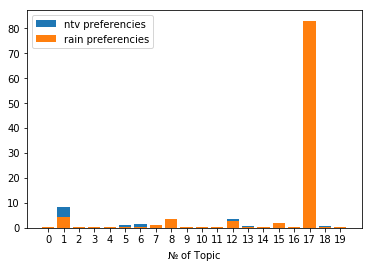

In [114]:
plt.bar(np.arange(0,20),distr_ntv, label = 'ntv preferencies')
plt.bar(np.arange(0,20),distr_rain, label = 'rain preferencies' )
plt.legend(loc='best')
plt.xlabel('$№$ of Topic')
plt.xticks(np.arange(0,20));

Посмотрели интересы по 100 рандомно выбранным группам у подписчиков дождя и подписчиков НТВ.

Можем видеть, что интересы почти одинаковы. В обеих группах лидер - тема связанные с патриотизмом, монархией, религией. В НТВ л.дей чуть больше интересует покупка/продажа товаров.В Дожде лидерует еще рецепты/кулинария, что в НТВ не так выражено. В остальном, можно заключить, что интересы практически одинаковы. Также можно отметить, что получается, что у подписчиков НТВ интересы более узкие, многие из топиков остались не заполнены, в то время как у Дождя все топик получили определенную долю.

In [115]:
distr_ntv

[0,
 8.324135194532573,
 0,
 0,
 0,
 1.166809767484665,
 1.6099071893841028,
 0.989100681617856,
 2.9670990305021405,
 0,
 0.08433984965085983,
 0,
 3.3843616330996156,
 0.8187186680734158,
 0,
 0.7697066953405738,
 0,
 78.36747746542096,
 0.669755756855011,
 0]

In [116]:
distr_rain

[0.12507113348692656,
 4.273921965621412,
 0.12507113348692656,
 0.12507113348692656,
 0.12507113348692656,
 0.12507113348692656,
 0.3369278749451041,
 1.280585021711886,
 3.491451922804117,
 0.12507113348692656,
 0.12507113348692656,
 0.12507113348692656,
 2.845749717205763,
 0.12507113348692656,
 0.12507113348692656,
 2.019409398548305,
 0.12507113348692656,
 83.10088253300637,
 0.12507113348692656,
 0.41482388507574797]

### Дополнительно:
- По любой группе пользователей построить матрицу Пользователь-Паблик, где 1 будет означать факт подписки на определенный паблик, 0 - отсутствие подписки (строки - пользователи, столбцы - паблики) и применить PCA - метод главных компонент, посмотреть, что из себя представляют топ-5 компонент и описать, какие интересы пользователей эти компоненты представляют

In [120]:
pd_us_gr = pd.DataFrame(np.zeros([len(uids),check_pd_20.shape[0]]),index = uids,columns = check_pd_20.index)

In [188]:
len(pd_us_gr)

1000

In [136]:
top_n = 5
groups = set(pd_us_gr.columns)
for ind in list(pd_us_gr.index):
    try:
        user_subs = vk_get_response(
            'users.getSubscriptions', 'user_id={0}&v=4.9&lang=ru'.format(int(ind)), access_token
        )
        if user_subs.get('response'):
            usr_gr = list(groups & set(user_subs['response']['groups'].get('items')[:top_n]))
            pd_us_gr.loc[ind,usr_gr] = 1 
    except Exception:
        print('1')


In [177]:
from sklearn.decomposition import PCA
pca1 = PCA().fit(pd_us_gr.values)


In [179]:
for i in range(1,20):
    print("n-components=%s, explained variance %.3f" % (i, sum(pca1.explained_variance_ratio_[:i])))

n-components=1, explained variance 0.034
n-components=2, explained variance 0.057
n-components=3, explained variance 0.070
n-components=4, explained variance 0.078
n-components=5, explained variance 0.086
n-components=6, explained variance 0.093
n-components=7, explained variance 0.100
n-components=8, explained variance 0.107
n-components=9, explained variance 0.114
n-components=10, explained variance 0.120
n-components=11, explained variance 0.126
n-components=12, explained variance 0.132
n-components=13, explained variance 0.138
n-components=14, explained variance 0.143
n-components=15, explained variance 0.149
n-components=16, explained variance 0.154
n-components=17, explained variance 0.159
n-components=18, explained variance 0.164
n-components=19, explained variance 0.169


In [180]:
x_pca = pca1.transform(pd_us_gr.values)

In [182]:
x_pca

array([[-6.04742035e-02, -4.55770901e-02, -4.11398614e-03, ...,
        -4.70841898e-16,  7.85233423e-17, -4.18766313e-16],
       [-6.13425549e-02, -4.70218205e-02, -5.06467561e-03, ...,
         2.77203390e-16,  8.72159333e-16, -5.76998844e-17],
       [-6.30907980e-02, -4.87432246e-02, -4.70224093e-03, ...,
         1.25116931e-16,  5.37764278e-17, -1.62630326e-16],
       ...,
       [-5.50131933e-02, -3.95613038e-02, -3.16945684e-03, ...,
        -3.70797143e-17,  2.61536669e-16, -1.88854466e-17],
       [-7.81010733e-02, -2.53472397e-02, -1.93967571e-02, ...,
        -2.60986436e-15,  2.79943711e-15,  4.43436656e-15],
       [-5.50131933e-02, -3.95613038e-02, -3.16945684e-03, ...,
        -3.70797143e-17,  2.61536669e-16, -1.88854466e-17]])

По графику можно сказать,что предпочтения пользователей достаточно сильно различимы.

Text(0,0.5,'second principal component')

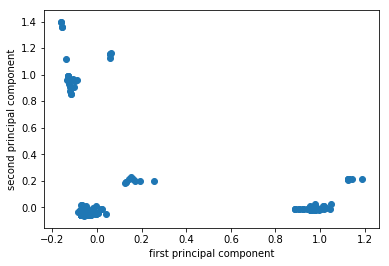

In [183]:
plt.scatter(x_pca[:, 0], x_pca[:, 1]) # linewidths=1, 
plt.xlabel("first principal component")
plt.ylabel("second principal component")

Text(0,0.5,'explained_variance_ratio_')

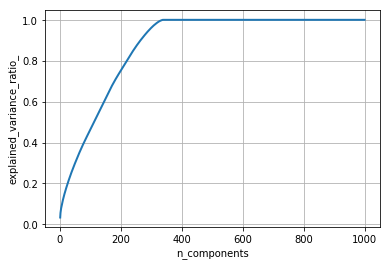

In [186]:
cum_evr = np.cumsum(pca1.explained_variance_ratio_)
xs = np.arange(cum_evr.size) + 1
plt.plot(xs, cum_evr, linewidth=2)
plt.grid()
plt.xlabel('n_components')
plt.ylabel('explained_variance_ratio_')

Можем видеть, что примерно 350 компонент объясняют 100% диперсии в данных

In [249]:
pca1.components_.shape[1
                      ]

2488

In [239]:
np.argmax(pca1.components_[0])

295

In [ ]:
np.argsort(pca1.components_[1],)[-2:]

In [261]:
pca1.components_[0][np.argsort(pca1.components_[0],)[-2:]]

array([0.17410529, 0.94379757])

In [240]:
pd_us_gr.iloc[:,np.argsort(pca1.components_[1],)[:5]].columns

Int64Index([68519692, 40316705, 31480508, 27932995, 40886007], dtype='int64')

In [257]:
for i in range(1,6):
        try:
            gr_name = []
            groups = pd_us_gr.iloc[:,np.argsort(pca1.components_[i])[-10:]].columns
            for idx in groups:
                group_info = vk_get_response(
                    'groups.getById', 'group_ids={0}&v=4.9&lang=ru'.format(idx), access_token
                )
                gr_name.append(group_info['response'][0]['name'] + ' ' + 'http://vk.com/club' + str(idx))
                time.sleep(0.3)
            print('Most typical group for {} component: '.format(i))
            print('-------------')
            print()
            print('\n'.join(gr_name))
            print()
        except:
            print("Response error. Group id {0}".format(i))
            #print(check)

Most typical group for 1 component: 
-------------

Наталия Орейро | Natalia Oreiro http://vk.com/club104052041
МК18+ : Мужской Клуб 18+ http://vk.com/club24532152
Первый канал http://vk.com/club25380626
Martin Garrix http://vk.com/club77397104
Warner Music Russia http://vk.com/club30462549
Jah Khalib http://vk.com/club26211015
Armin van Buuren http://vk.com/club42743690
Hardwell http://vk.com/club56074769
РИА Новости http://vk.com/club15755094
НТВ http://vk.com/club28658784

Most typical group for 2 component: 
-------------

Телеканал 2х2 http://vk.com/club48864
Темная сторона http://vk.com/club19799369
Комсомольская правда - KP.RU http://vk.com/club15722194
Москва 24 http://vk.com/club35068738
Фестиваль Аврора http://vk.com/club15260252
Программирование ITmozg: http://vk.com/club16108331
WWF России - Всемирный фонд дикой природы http://vk.com/club348403
ВЕДОМОСТИ http://vk.com/club15548215
LIVE http://vk.com/club2158488
РИА Новости http://vk.com/club15755094

Most typical group for 

1 - компонента похоже отвечает за определенню музыку (похоже больше связано с мужскими интересами), вторая- за новости, третья - кино,направление 4 достаточно трудно опередилить, очень похоже на 1, пятая - больше похоже на юмор.